In [2]:
!nvidia-smi

Fri Feb 28 18:22:03 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.216.01             Driver Version: 535.216.01   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA L4                      On  | 00000000:00:03.0 Off |                    0 |
| N/A   36C    P8              11W /  72W |      0MiB / 23034MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [1]:
import numpy as np

In [3]:
palette ={ 0 : (0,0,0),  #no data 
           1 : (128, 255, 0), #forest
           2 : (166, 0, 204), #mine
           3 : (204, 0, 0), #road
           4 : (255, 0, 0), #disc urban   
           5 : (255, 255, 168), #arable land
           6 : (255,230,166), #heteregonous agricultural areas
           7 : (231, 40, 252), #permenant crops
           8 : (0, 204, 242),  #inland waters
           9 : (255, 166, 255),  #artificial non-agricultural vegetated areas
           10: (204, 77, 242), #industrial or commercial units
           11: (204, 242, 77), #shrub and/or herbaceous vegetation
           12: (230, 0, 77) #continuous urban fabric
         }

invert_palette = {v: k for k, v in palette.items()}

id2label = {
    0: "No Data",
    1: "Forest",
    2: "Mine",
    3: "Road",
    4: "Discontinuous Urban",
    5: "Arable Land",
    6: "Heterogeneous Agricultural Areas",
    7: "Permanent Crops",
    8: "Inland Waters",
    9: "Artificial Non-Agricultural Vegetated Areas",
    10: "Industrial or commercial units",
    11: "Shrub or herbaceous vegetation",
    12: "Continuous urban fabric"
}

label2id = {label: id for id, label in id2label.items()}

NUM_CLASSES = len(id2label)

def convert_to_color(arr_2d, palette=palette):
    """ Numeric labels to RGB-color encoding """
    arr_3d = np.zeros((arr_2d.shape[0], arr_2d.shape[1], 3), dtype=np.uint8)

    for c, i in palette.items():
        m = arr_2d == c
        arr_3d[m] = i

    return arr_3d

def convert_from_color(arr_3d, palette=invert_palette):
    """ RGB-color encoding to grayscale labels """
    arr_2d = np.zeros((arr_3d.shape[0], arr_3d.shape[1]), dtype=np.uint8)

    for c, i in palette.items():
        m = np.all(arr_3d == np.array(c).reshape(1, 1, 3), axis=2)
        arr_2d[m] = i

    return arr_2d

NUM_CLASSES

13

In [4]:
class_to_prompt_dict = {
    "No Data": "No Data",
    "Forest": "Forest",
    "Mine": "Bareland",
    "Road": "Road",
    "Discontinuous Urban": "Building",
    "Arable Land": "Agriculture",
    "Heterogeneous Agricultural Areas": "Agriculture",
    "Permanent Crops": "Agriculture",
    "Inland Waters": "Water",
    "Artificial Non-Agricultural Vegetated Areas": "Building",
    "Industrial or commercial units": "Building",
    "Shrub or herbaceous vegetation": "Shrub",
    "Continuous urban fabric": "Building"
}

# Create a list of unique prompt classes
unique_prompt_classes = list(set(class_to_prompt_dict.values()))

# Create mappings between prompt classes and IDs
prompt2id = {prompt_class: idx for idx, prompt_class in enumerate(unique_prompt_classes)}
id2prompt = {idx: prompt_class for idx, prompt_class in enumerate(unique_prompt_classes)}

prompt_label2id = prompt2id
prompt_id2label = id2prompt

# Create palette for prompt classes
palette_prompt = {}
for original_id, color in palette.items():
    original_label = id2label[original_id]
    prompt_class = class_to_prompt_dict[original_label]
    prompt_id = prompt2id[prompt_class]
    # We might have multiple original classes mapping to the same prompt class
    # In case of conflicts, we're using the last assignment
    palette_prompt[prompt_id] = color

# Create the inverse palette for prompt classes
invert_palette_prompt = {v: k for k, v in palette_prompt.items()}

prompt_palette = palette_prompt
prompt_invert_palette = invert_palette_prompt

H, W = 512, 512

PROMPT_NUM_CLASSES = len(prompt_id2label)

def convert_to_color_prompt(arr_2d, palette=palette_prompt):
    """
    Convert numeric labels in prompt class space to RGB-color encoding
    
    Args:
        arr_2d: 2D array with prompt class IDs
        palette: Dictionary mapping prompt class IDs to RGB colors
        
    Returns:
        3D array with RGB color encoding
    """
    arr_3d = np.zeros((arr_2d.shape[0], arr_2d.shape[1], 3), dtype=np.uint8)

    for c, i in palette.items():
        m = arr_2d == c
        arr_3d[m] = i

    return arr_3d

def convert_from_color_prompt(arr_3d, palette=invert_palette_prompt):
    """
    Convert RGB-color encoding to prompt class IDs
    
    Args:
        arr_3d: 3D array with RGB color encoding
        palette: Dictionary mapping RGB colors to prompt class IDs
        
    Returns:
        2D array with prompt class IDs
    """
    arr_2d = np.zeros((arr_3d.shape[0], arr_3d.shape[1]), dtype=np.uint8)

    for c, i in palette.items():
        m = np.all(arr_3d == np.array(c).reshape(1, 1, 3), axis=2)
        arr_2d[m] = i

    return arr_2d

def original_class_to_prompt_class(original_id):
    """
    Convert original class ID to prompt class ID
    
    Args:
        original_id: Original class ID
        
    Returns:
        Prompt class ID
    """
    original_label = id2label[original_id]
    prompt_class = class_to_prompt_dict[original_label]
    return prompt2id[prompt_class]

def convert_original_mask_to_prompt_mask(original_mask):
    """
    Convert a mask with original class IDs to a mask with prompt class IDs
    
    Args:
        original_mask: 2D array with original class IDs
        
    Returns:
        2D array with prompt class IDs
    """
    prompt_mask = np.zeros_like(original_mask)
    
    for original_id in np.unique(original_mask):
        if original_id in id2label:
            prompt_id = original_class_to_prompt_class(original_id)
            prompt_mask[original_mask == original_id] = prompt_id
            
    return prompt_mask

# Display information about the prompt classes
print("Prompt Classes:")
for idx, prompt_class in id2prompt.items():
    print(f"ID: {idx}, Class: {prompt_class}, Color: {palette_prompt.get(idx, 'Not assigned')}")
    
print("\nOriginal to Prompt Class Mapping:")
for original_label, prompt_class in class_to_prompt_dict.items():
    original_id = label2id[original_label]
    prompt_id = prompt2id[prompt_class]
    print(f"Original: {original_id} ({original_label}) -> Prompt: {prompt_id} ({prompt_class})")

Prompt Classes:
ID: 0, Class: Road, Color: (204, 0, 0)
ID: 1, Class: Bareland, Color: (166, 0, 204)
ID: 2, Class: No Data, Color: (0, 0, 0)
ID: 3, Class: Water, Color: (0, 204, 242)
ID: 4, Class: Shrub, Color: (204, 242, 77)
ID: 5, Class: Agriculture, Color: (231, 40, 252)
ID: 6, Class: Forest, Color: (128, 255, 0)
ID: 7, Class: Building, Color: (230, 0, 77)

Original to Prompt Class Mapping:
Original: 0 (No Data) -> Prompt: 2 (No Data)
Original: 1 (Forest) -> Prompt: 6 (Forest)
Original: 2 (Mine) -> Prompt: 1 (Bareland)
Original: 3 (Road) -> Prompt: 0 (Road)
Original: 4 (Discontinuous Urban) -> Prompt: 7 (Building)
Original: 5 (Arable Land) -> Prompt: 5 (Agriculture)
Original: 6 (Heterogeneous Agricultural Areas) -> Prompt: 5 (Agriculture)
Original: 7 (Permanent Crops) -> Prompt: 5 (Agriculture)
Original: 8 (Inland Waters) -> Prompt: 3 (Water)
Original: 9 (Artificial Non-Agricultural Vegetated Areas) -> Prompt: 7 (Building)
Original: 10 (Industrial or commercial units) -> Prompt: 7 (B

In [5]:
import os
import numpy as np
import rasterio

images_folder_path = "samgeo/WorldView/Test/Image_Int8_v2"
masks_folder_path = "samgeo/WorldView/Test/Mask"

def read_image(image_path):
    with rasterio.open(image_path) as src:
        return src.read()
    
def read_mask(mask_path):
    with rasterio.open(mask_path) as src:
        return src.read()
    
def read_image_and_mask(name):
    image_path = os.path.join(images_folder_path, name)
    mask_path = os.path.join(masks_folder_path, name)
    
    image = read_image(image_path)
    mask = read_mask(mask_path)

    return image, mask

In [6]:
from samgeo import SamGeo2

sam2 = SamGeo2(
    model_id="sam2-hiera-large",
    automatic=True,
)

In [6]:
from samgeo import SamGeo

sam = SamGeo(
    model_type="vit_h",
    sam_kwargs=None,
    torch_dtype="float32"
)

Model checkpoint for vit_h not found.


Downloading...
From: https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth
To: /home/gcp-user/.cache/torch/hub/checkpoints/sam_vit_h_4b8939.pth
100%|██████████| 2.56G/2.56G [00:26<00:00, 96.4MB/s]


(4, 512, 512) (512, 512, 3)
(512, 512)


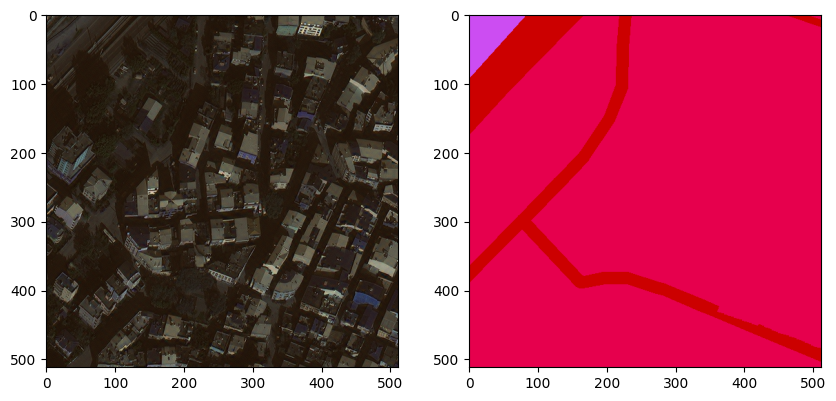

In [6]:
names = os.listdir(images_folder_path)
name = names[12]

image_path = os.path.join(images_folder_path, name)

image, colored_mask = read_image_and_mask(name)
colored_mask = np.moveaxis(colored_mask, 0, -1)
print(image.shape, colored_mask.shape)

mask = convert_from_color(colored_mask)
print(mask.shape)

import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.imshow(np.moveaxis(image[:3], 0, -1))
plt.subplot(1, 2, 2)
plt.imshow(colored_mask)
plt.show()


In [10]:
sam2.generate(image_path, foreground=True, unique=True)

In [11]:
sam2.show_masks(cmap="binary_r")

AttributeError: 'SamGeo2' object has no attribute 'objects'

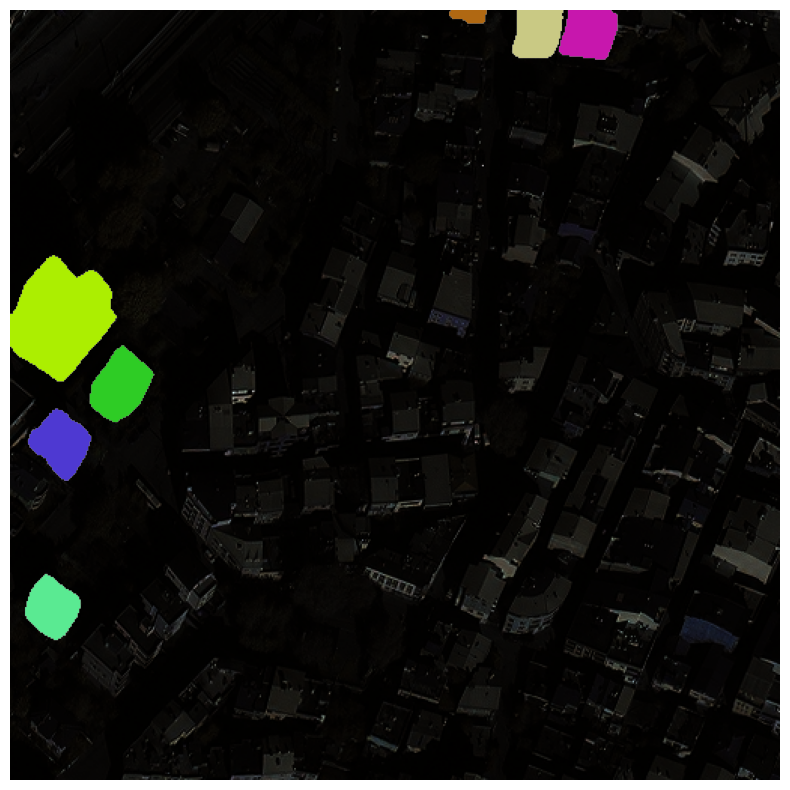

In [17]:
sam2.show_anns(axis="off", alpha=1)

In [12]:
sam.generate(image_path, foreground=True)

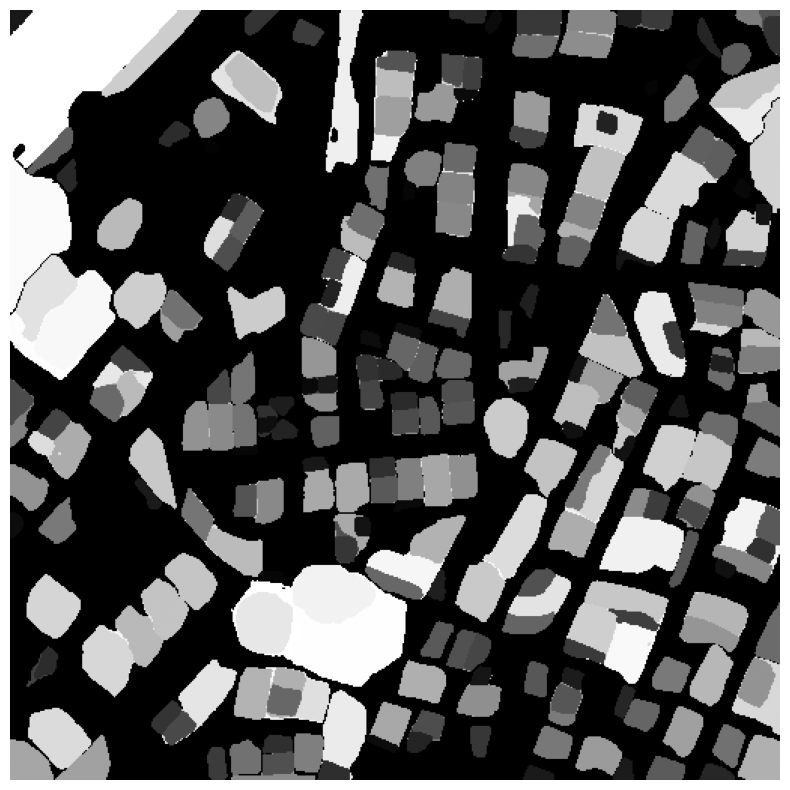

In [13]:
sam.show_masks(cmap="binary_r")

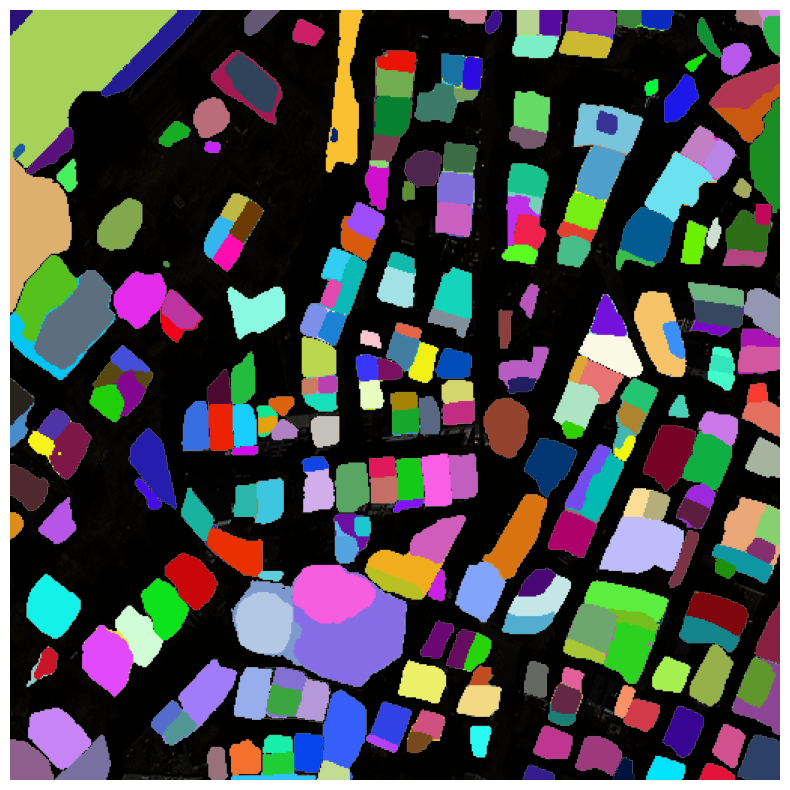

In [14]:
sam.show_anns(axis="off", alpha=1)

In [1]:
from samgeo.hq_sam import SamGeo as HQSamGeo

hqsam = HQSamGeo(
    model_type="vit_h",  # can be vit_h, vit_b, vit_l, vit_tiny
    sam_kwargs=None,
    checkpoint_dir='/home/gcp-user/.cache/torch/hub/checkpoints/'
)

/home/gcp-user/cmh_test/myenv/lib/python3.11/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/home/gcp-user/cmh_test/myenv/lib/python3.11/site-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/home/gcp-user/cmh_test/myenv/lib/python3.11/site-packages/segment_anything_hq/modeling/tiny_vit_sam.py:662: UserWarning: Overwriting tiny_vit_5m_224 in registry with segment_anything_hq.modeling.tiny_vit_sam.tiny_vit_5m_224. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  return register_model(fn_wrapper)
/home/gcp-user/cmh_test/myenv/lib/python3.1

_IncompatibleKeys(missing_keys=['mask_decoder.hf_token.weight', 'mask_decoder.hf_mlp.layers.0.weight', 'mask_decoder.hf_mlp.layers.0.bias', 'mask_decoder.hf_mlp.layers.1.weight', 'mask_decoder.hf_mlp.layers.1.bias', 'mask_decoder.hf_mlp.layers.2.weight', 'mask_decoder.hf_mlp.layers.2.bias', 'mask_decoder.compress_vit_feat.0.weight', 'mask_decoder.compress_vit_feat.0.bias', 'mask_decoder.compress_vit_feat.1.weight', 'mask_decoder.compress_vit_feat.1.bias', 'mask_decoder.compress_vit_feat.3.weight', 'mask_decoder.compress_vit_feat.3.bias', 'mask_decoder.embedding_encoder.0.weight', 'mask_decoder.embedding_encoder.0.bias', 'mask_decoder.embedding_encoder.1.weight', 'mask_decoder.embedding_encoder.1.bias', 'mask_decoder.embedding_encoder.3.weight', 'mask_decoder.embedding_encoder.3.bias', 'mask_decoder.embedding_maskfeature.0.weight', 'mask_decoder.embedding_maskfeature.0.bias', 'mask_decoder.embedding_maskfeature.1.weight', 'mask_decoder.embedding_maskfeature.1.bias', 'mask_decoder.embedd

In [11]:
hqsam.generate(image_path, foreground=True, unique=True)

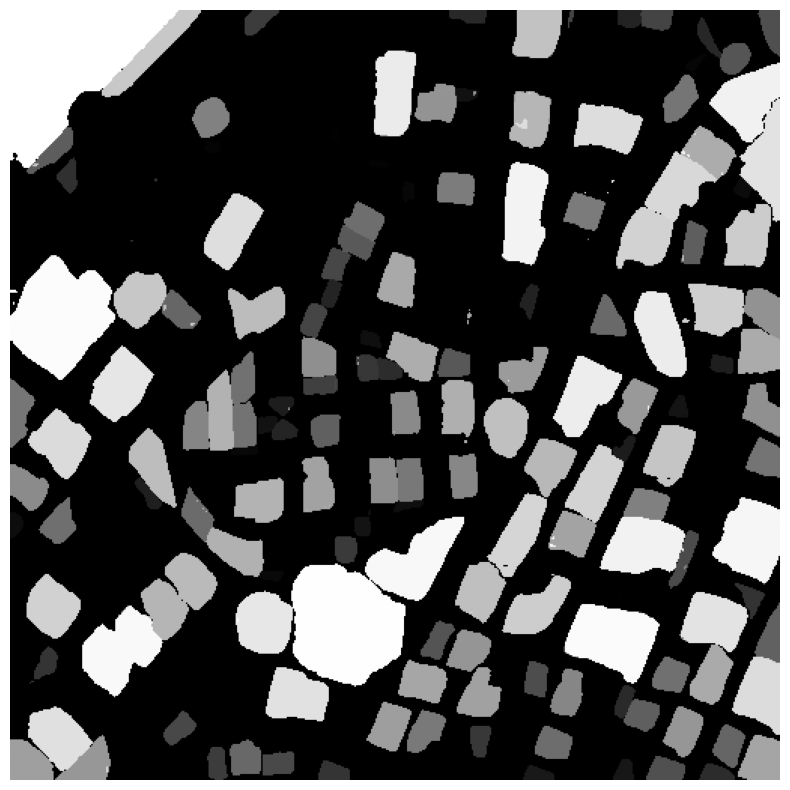

In [9]:
hqsam.show_masks(cmap="binary_r")

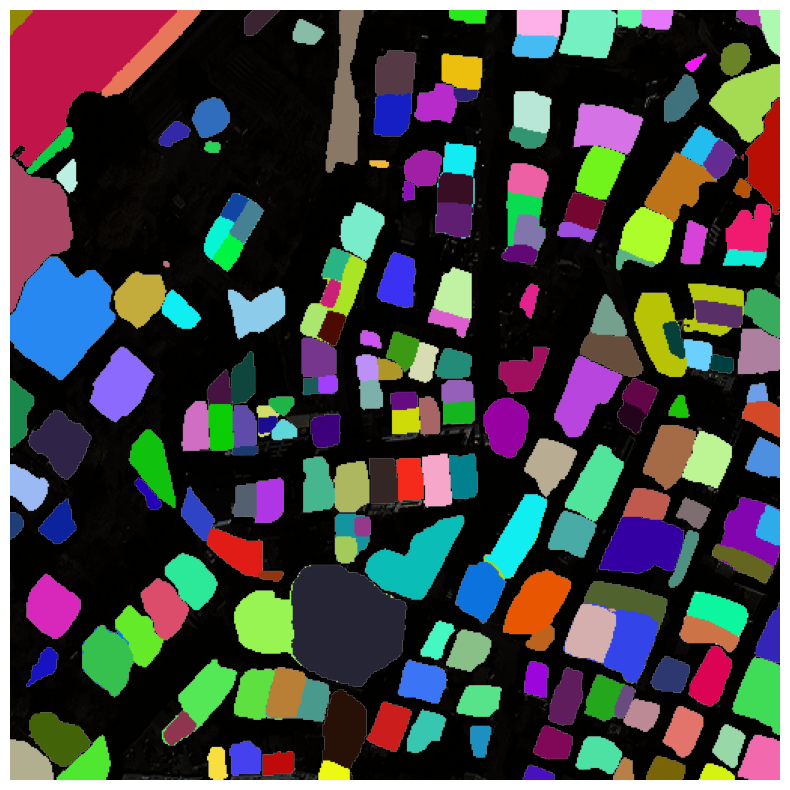

In [12]:
hqsam.show_anns(axis="off", alpha=1,  output="test.png")

# Show Image, GT, LangSAM, SAM, SAM2, HQSAM Examples

## Predict Every Image With SAM, SAM2, HQSAM

In [7]:
from samgeo import SamGeo

sam = SamGeo(
    model_type="vit_h",
    sam_kwargs=None,
    torch_dtype="float32"
)

from samgeo import SamGeo2

sam2 = SamGeo2(
    model_id="sam2-hiera-large",
    automatic=True,
)

from samgeo.hq_sam import SamGeo as HQSamGeo

hqsam = HQSamGeo(
    model_type="vit_h",  # can be vit_h, vit_b, vit_l, vit_tiny
    sam_kwargs=None,
    checkpoint_dir='/home/gcp-user/.cache/torch/hub/checkpoints/'
)

KeyboardInterrupt: 

In [ ]:
from tqdm import tqdm

In [ ]:
sam_out_folder = "samgeo/WorldView/Test/Mask_SAM"
sam2_out_folder = "samgeo/WorldView/Test/Mask_SAM2"
hqsam_out_folder = "samgeo/WorldView/Test/Mask_HQSAM"

for name in tqdm(names):
    image_path = os.path.join(images_folder_path, name)

    sam.generate(image_path, foreground=True, unique=True)
    sam2.generate(image_path, foreground=True, unique=True)
    hqsam.generate(image_path, foreground=True, unique=True)
        
    sam_out_file = os.path.join(sam_out_folder, name)
    sam2_out_file = os.path.join(sam2_out_folder, name)
    hqsam_out_file = os.path.join(hqsam_out_folder, name)

    sam.show_anns(axis="off", alpha=1,  output=sam_out_file)
    sam2.show_anns(axis="off", alpha=1,  output=sam2_out_file)
    hqsam.show_anns(axis="off", alpha=1,  output=hqsam_out_file)

In [13]:
sam_out_folder = "samgeo/WorldView/Test/Mask_SAM"
sam2_out_folder = "samgeo/WorldView/Test/Mask_SAM2"
hqsam_out_folder = "samgeo/WorldView/Test/Mask_HQSAM"

os.makedirs(sam_out_folder, exist_ok=True)
os.makedirs(sam2_out_folder, exist_ok=True)
os.makedirs(hqsam_out_folder, exist_ok=True)

In [17]:
from tqdm import tqdm
from matplotlib import pyplot as plt

plt.ioff()

for name in tqdm(names):
    image_path = os.path.join(images_folder_path, name)

    sam.generate(image_path, foreground=True, unique=True)
    sam2.generate(image_path, foreground=True, unique=True)
    hqsam.generate(image_path, foreground=True, unique=True)
        
    sam_out_file = os.path.join(sam_out_folder, name)
    sam2_out_file = os.path.join(sam2_out_folder, name)
    hqsam_out_file = os.path.join(hqsam_out_folder, name)

    sam.show_anns(axis="off", alpha=1,  output=sam_out_file)
    sam2.show_anns(axis="off", alpha=1,  output=sam2_out_file)
    hqsam.show_anns(axis="off", alpha=1,  output=hqsam_out_file)

  0%|          | 0/122 [00:00<?, ?it/s]/home/gcp-user/cmh_test/myenv/lib/python3.11/site-packages/samgeo/hq_sam.py:365: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=figsize)
100%|██████████| 122/122 [18:43<00:00,  9.21s/it]


## Visualizing Predictions

In [9]:
from samgeo.text_sam import LangSAM

langsam = LangSAM(model_type="sam2-hiera-large")

final text_encoder_type: bert-base-uncased


In [10]:
sam_mask_folder = "samgeo/WorldView/Test/Mask_SAM"
sam2_mask_folder = "samgeo/WorldView/Test/Mask_SAM2"
hqsam_mask_folder = "samgeo/WorldView/Test/Mask_HQSAM"

In [12]:
box_threshold = 0.1
text_threshold = 0.2

def predict(image_path, mask):    
    # Ground truth mask
    one_hot_mask = np.eye(PROMPT_NUM_CLASSES)[mask]
    one_hot_mask = np.moveaxis(one_hot_mask, -1, 0)
    
    # Initialize a tensor to store logits for all classes
    H, W = mask.shape
    all_logits = np.zeros((PROMPT_NUM_CLASSES, H, W), dtype=np.float32)
    all_masks = np.zeros((PROMPT_NUM_CLASSES, H, W), dtype=np.uint8)
    
    unique_classes = np.unique(mask)
    for class_index, class_name in prompt_id2label.items():
        # if class_index == 0:  # Skip background/unknown class
        #     continue
        if class_index not in unique_classes:
            continue
            
        # class_prompt = class_to_prompt_dict[class_name]
        class_prompt = class_name
        masks, boxes, phrases, logits = langsam.predict(image_path, class_prompt, box_threshold=box_threshold, text_threshold=text_threshold, return_results=True)
        
        if len(masks) == 0:
            continue
            
        # Combine masks based on logits
        for i, (mask_i, logit_i) in enumerate(zip(masks, logits)):            
            # Convert logit_i from tensor to numpy if necessary
            if not isinstance(logit_i, (np.ndarray, np.number, float, int)):
                # For PyTorch tensors
                if hasattr(logit_i, 'detach') and hasattr(logit_i, 'cpu') and hasattr(logit_i, 'numpy'):
                    logit_i = logit_i.detach().cpu().numpy()
                # For TensorFlow tensors
                elif hasattr(logit_i, 'numpy'):
                    logit_i = logit_i.numpy()
                else:
                    logit_i = float(logit_i)  # Fallback to simple float conversion
            
            # Update the logits where the mask is active
            all_logits[class_index] = np.maximum(all_logits[class_index], mask_i * logit_i)
            all_masks[class_index] = np.maximum(all_masks[class_index], mask_i)
    
    # Create final mask by selecting the class with highest logit for each pixel
    final_mask = np.zeros((H, W), dtype=np.uint8)
    
    # First check if any class was detected at each pixel
    detected_pixels = np.max(all_masks, axis=0) > 0
    
    # For pixels where at least one class was detected, assign the class with highest logit
    if np.any(detected_pixels):
        # Get the class with highest logit for each pixel
        best_class_indices = np.argmax(all_logits, axis=0)
        
        # Only assign a class if the pixel was detected by at least one mask
        final_mask[detected_pixels] = best_class_indices[detected_pixels]
    return final_mask

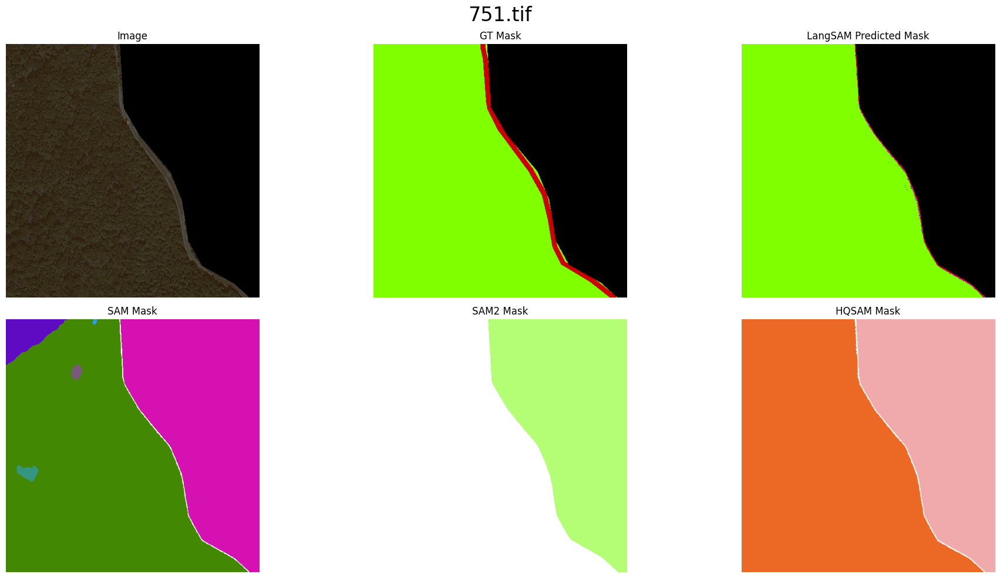

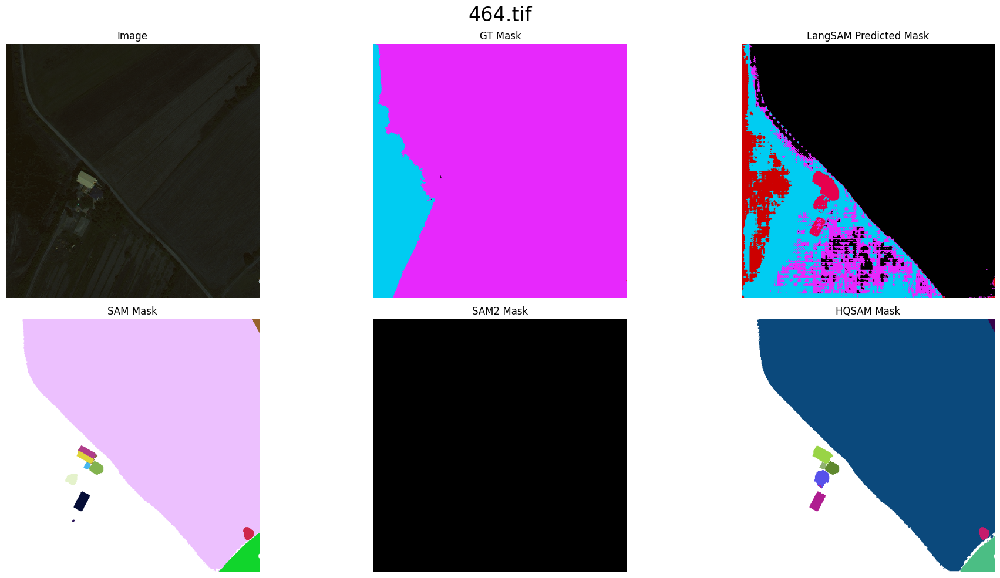

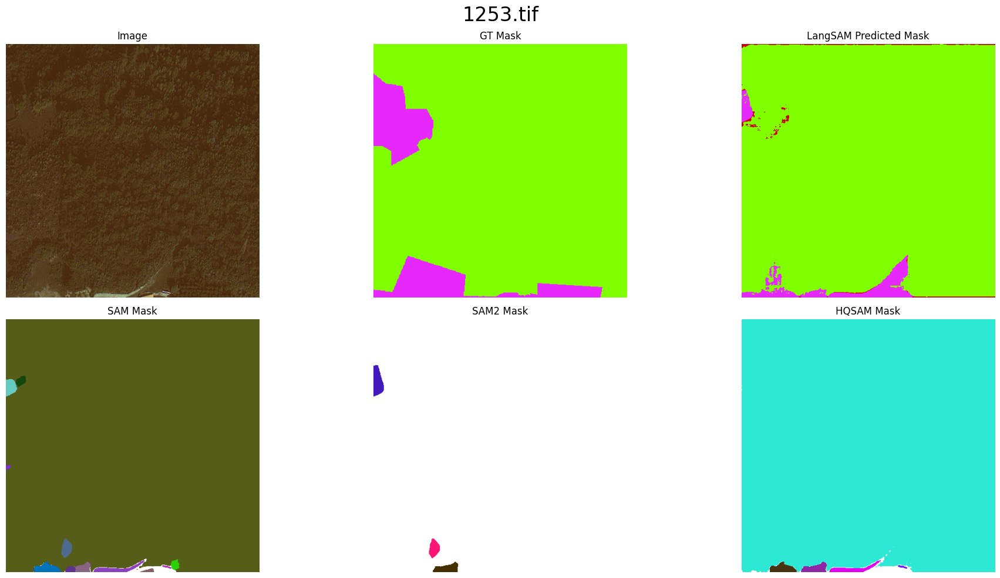

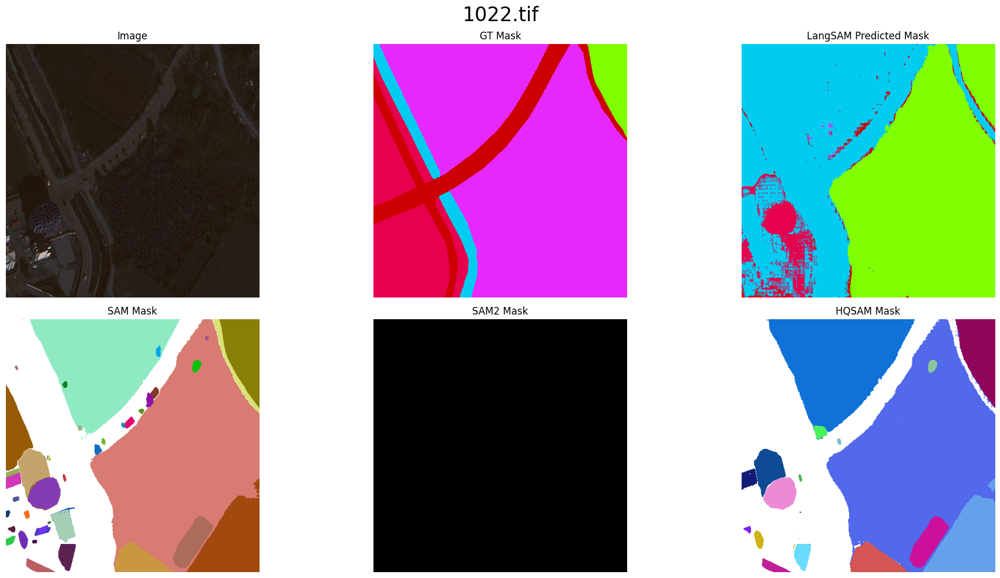

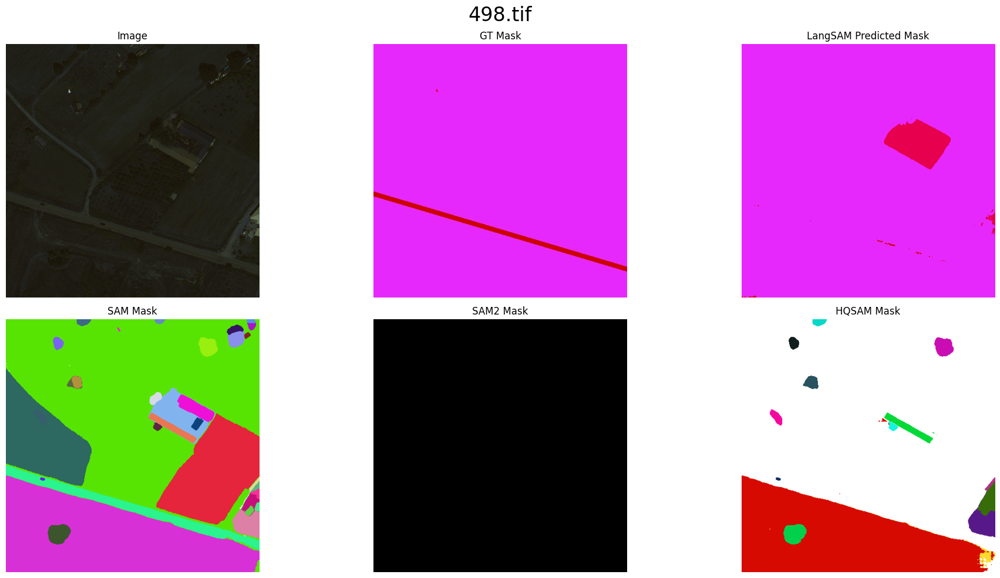

...

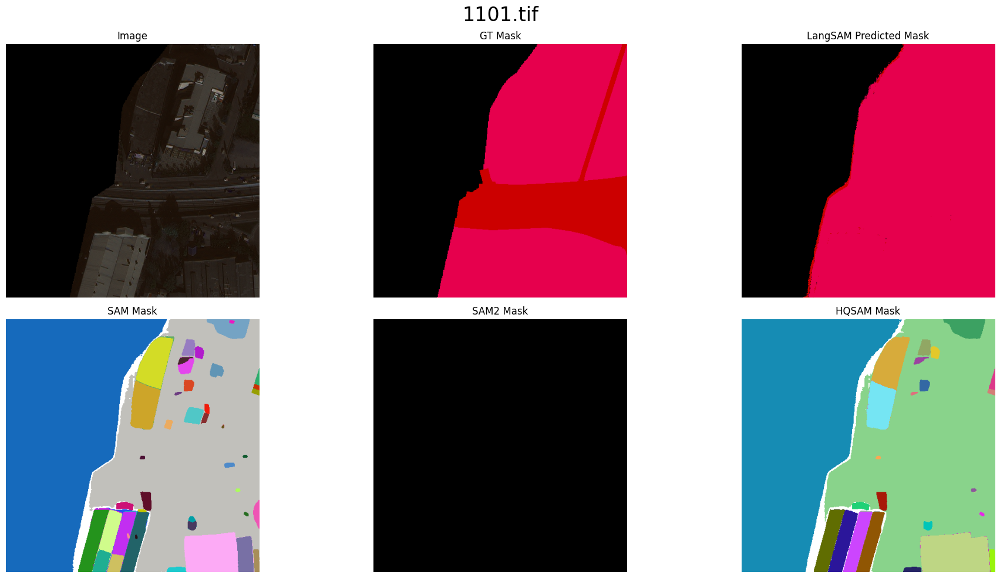

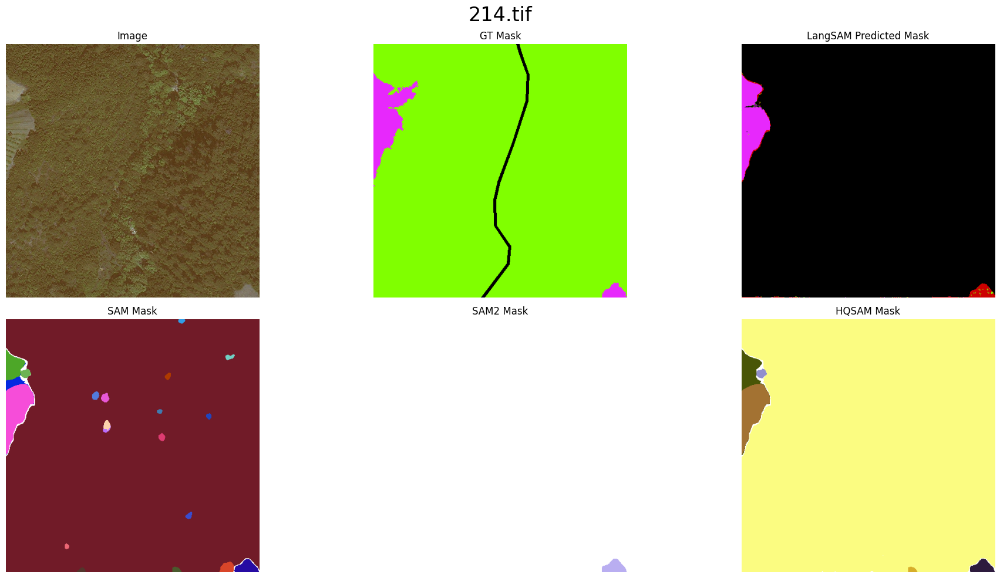

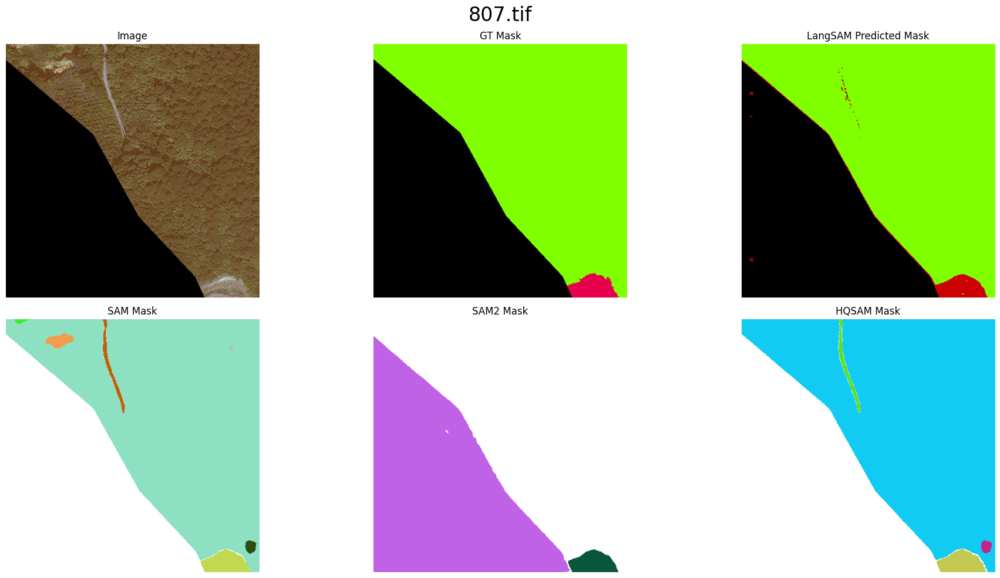

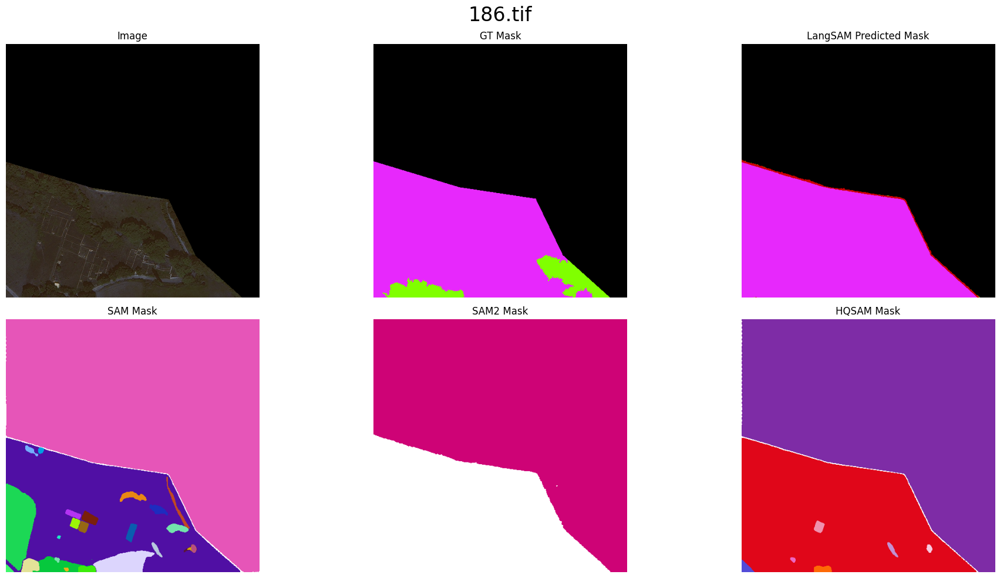

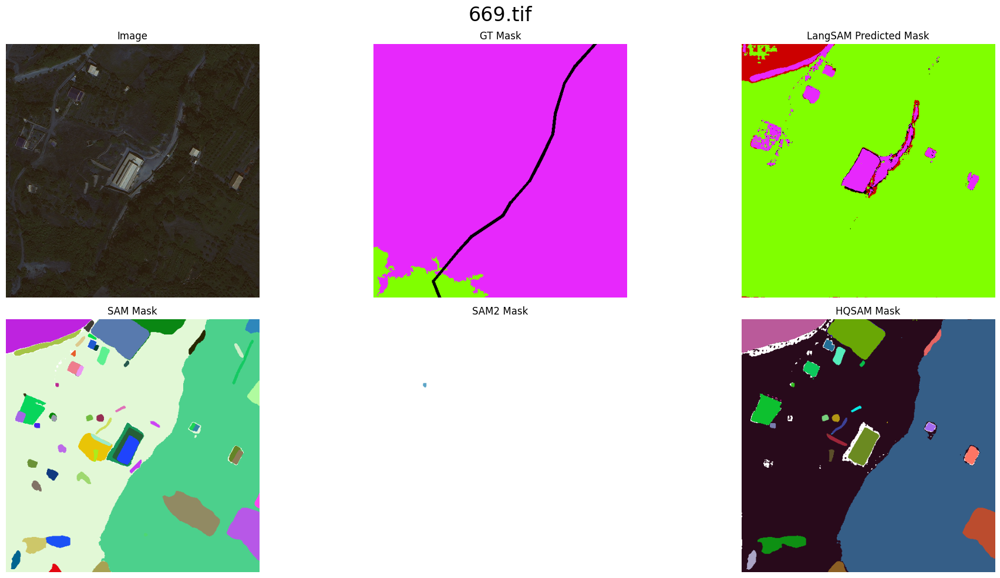

In [25]:
from tqdm import tqdm
import numpy as np
import os
import random

names = os.listdir(images_folder_path)

random_names = random.sample(names, 50)

for name in random_names:
    image_path = os.path.join(images_folder_path, name)

    image, colored_mask = read_image_and_mask(name)
    
    colored_mask = np.moveaxis(colored_mask, 0, -1)

    mask_old = convert_from_color(colored_mask)
    mask = convert_original_mask_to_prompt_mask(mask_old)

    final_mask = predict(image_path, mask)

    langsam_colored_mask = convert_to_color_prompt(final_mask)
    gt_colored_mask = convert_to_color_prompt(mask)

    sam_file = os.path.join(sam_mask_folder, name)
    sam2_file = os.path.join(sam2_mask_folder, name)
    hqsam_file = os.path.join(hqsam_mask_folder, name)
    
    if not os.path.exists(sam_file):
        sam_colored_mask = np.zeros_like(colored_mask)
    else:
        sam_colored_mask = np.moveaxis(read_image(sam_file), 0, -1)
    
    if not os.path.exists(sam2_file):
        sam2_colored_mask = np.zeros_like(colored_mask)
    else:
        sam2_colored_mask = np.moveaxis(read_image(sam2_file), 0, -1)

    if not os.path.exists(hqsam_file):
        hqsam_colored_mask = np.zeros_like(colored_mask)
    else:
        hqsam_colored_mask = np.moveaxis(read_image(hqsam_file), 0, -1)
    
    plt.figure(figsize=(20, 10))

    plt.suptitle(name, fontsize=24)
    
    rows = 2
    cols = 3
    # First row
    plt.subplot(rows, cols, 1)
    plt.imshow(np.moveaxis(image[:3], 0, -1))
    plt.title("Image")
    plt.axis("off")
    
    plt.subplot(rows, cols, 2)
    plt.imshow(gt_colored_mask)
    plt.title("GT Mask")
    plt.axis("off")
    
    plt.subplot(rows, cols, 3)
    plt.imshow(langsam_colored_mask)
    plt.title("LangSAM Predicted Mask")
    plt.axis("off")
    
    # Second row
    plt.subplot(rows, cols, 4)
    plt.imshow(sam_colored_mask)
    plt.title("SAM Mask")
    plt.axis("off")
    
    plt.subplot(rows, cols, 5)
    plt.imshow(sam2_colored_mask)
    plt.title("SAM2 Mask")
    plt.axis("off")
    
    plt.subplot(rows, cols, 6)
    plt.imshow(hqsam_colored_mask)
    plt.title("HQSAM Mask")
    plt.axis("off")
    
    plt.tight_layout()
    plt.show()

    # assert False